<a href="https://colab.research.google.com/github/hodgesr2/Drug-Discovery-Google-Colab---SARS/blob/master/Drug_Discovery_Portfolio_Project_SARS_Google_Colab_Version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is a small drug discovery bioinformatics project. We are searching for molecules that could be taken orally by a human to treat SARS.
- Robert Hodges, PharmD, MBA, RPh


In [ ]:
pip install chembl_webresource_client

In [ ]:
! wget https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh
! chmod +x Miniconda3-py37_4.8.3-Linux-x86_64.sh
! bash ./Miniconda3-py37_4.8.3-Linux-x86_64.sh -b -f -p /usr/local
! conda install -c rdkit rdkit -y

--2020-09-06 00:22:10--  https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.130.3, 104.16.131.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.130.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 88867207 (85M) [application/x-sh]
Saving to: ‘Miniconda3-py37_4.8.3-Linux-x86_64.sh.3’

Miniconda3-py37_4.8 100%[===================>]  84.75M   261MB/s    in 0.3s    

2020-09-06 00:22:10 (261 MB/s) - ‘Miniconda3-py37_4.8.3-Linux-x86_64.sh.3’ saved [88867207/88867207]

PREFIX=/usr/local
Unpacking payload ...
Solving environment: / - \ | / - \ done

## Package Plan ##

  environment location: /usr/local

  added / updated specs:
    - _libgcc_mutex==0.1=main
    - ca-certificates==2020.1.1=0
    - certifi==2020.4.5.1=py37_0
    - cffi==1.14.0=py37he30daa8_1
    - chardet==3.0.4=py37_1003
    - conda-package-handling==1.6.1=py37h7b6447c

In [ ]:
!time conda install -q -y -c conda-forge rdkit

Solving environment: ...working... done

## Package Plan ##

  environment location: /usr/local

  added / updated specs:
    - rdkit


The following packages will be UPDATED:

  conda                       pkgs/main::conda-4.8.4-py37_0 --> conda-forge::conda-4.8.4-py37hc8dfbb8_2
  openssl              pkgs/main::openssl-1.1.1g-h7b6447c_0 --> conda-forge::openssl-1.1.1g-h516909a_1

The following packages will be SUPERSEDED by a higher-priority channel:

  ca-certificates    pkgs/main::ca-certificates-2020.7.22-0 --> conda-forge::ca-certificates-2020.6.20-hecda079_0
  certifi               pkgs/main::certifi-2020.6.20-py37_0 --> conda-forge::certifi-2020.6.20-py37hc8dfbb8_0


Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done

real	0m7.672s
user	0m6.684s
sys	0m1.006s


In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import sys
import os
sys.path.append('/usr/local/lib/python3.7/site-packages/')  ### This is needed to make sure we can import RDKit in Google Colab.

In [ ]:
import pandas as pd
from chembl_webresource_client.new_client import new_client

In [ ]:
target = new_client.target
target_query = target.search('coronavirus')
targets = pd.DataFrame.from_dict(target_query)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)
targets

,cross_references,organism,pref_name,score,species_group_flag,target_chembl_id,target_components,target_type,tax_id
0,[],Coronavirus,Coronavirus,17.0,False,CHEMBL613732,[],ORGANISM,11119
1,[],SARS coronavirus,SARS coronavirus,14.0,False,CHEMBL612575,[],ORGANISM,227859
2,[],Feline coronavirus,Feline coronavirus,14.0,False,CHEMBL612744,[],ORGANISM,12663
3,[],Human coronavirus 229E,Human coronavirus 229E,13.0,False,CHEMBL613837,[],ORGANISM,11137
4,"[{'xref_id': 'P0C6U8', 'xref_name': None, 'xre...",SARS coronavirus,SARS coronavirus 3C-like proteinase,10.0,False,CHEMBL3927,"[{'accession': 'P0C6U8', 'component_descriptio...",SINGLE PROTEIN,227859
5,[],Middle East respiratory syndrome-related coron...,Middle East respiratory syndrome-related coron...,9.0,False,CHEMBL4296578,[],ORGANISM,1335626
6,"[{'xref_id': 'P0C6X7', 'xref_name': None, 'xre...",SARS coronavirus,Replicase polyprotein 1ab,5.0,False,CHEMBL5118,"[{'accession': 'P0C6X7', 'component_descriptio...",SINGLE PROTEIN,227859


In [ ]:
selected_target = targets.target_chembl_id[6]
selected_target

'CHEMBL5118'

In [ ]:
activity = new_client.activity
res = activity.filter(target_chembl_id=selected_target)

In [ ]:
df = pd.DataFrame.from_dict(res)

In [ ]:
df.head(10)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1988091,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL194398,None,CHEMBL194398,None,False,http://www.openphacts.org/units/Nanomolar,663132,=,1,True,=,None,IC50,nM,None,870000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,870.0
1,None,1988092,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL393608,None,CHEMBL393608,None,False,http://www.openphacts.org/units/Nanomolar,663138,=,1,True,=,None,IC50,nM,None,200000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,200.0
2,None,1988093,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL238216,None,CHEMBL238216,None,False,http://www.openphacts.org/units/Nanomolar,663137,=,1,True,=,None,IC50,nM,None,300000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,300.0
3,None,1988094,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.31', 'le': '0.14', 'lle': '3.95', '...",CHEMBL235873,None,CHEMBL235873,4.82,False,http://www.openphacts.org/units/Nanomolar,663136,=,1,True,=,None,IC50,nM,None,15000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,15.0
4,None,1988095,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.99', 'le': '0.16', 'lle': '4.33', '...",CHEMBL397154,None,CHEMBL397154,5.00,False,http://www.openphacts.org/units/Nanomolar,663135,=,1,True,=,None,IC50,nM,None,10000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,10.0
5,None,1988096,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '6.43', 'le': '0.12', 'lle': '2.03', '...",CHEMBL238217,None,CHEMBL238217,4.10,False,http://www.openphacts.org/units/Nanomolar,663134,=,1,True,=,None,IC50,nM,None,80000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,80.0
6,None,1988097,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CH

Narrowing down to type IC50

In [ ]:
activity2 = new_client.activity
res2 = activity2.filter(target_chembl_id=selected_target).filter(type='IC50')

In [ ]:
df2 = pd.DataFrame.from_dict(res2)
df2.head(10)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1988091,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL194398,None,CHEMBL194398,None,False,http://www.openphacts.org/units/Nanomolar,663132,=,1,True,=,None,IC50,nM,None,870000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,870.0
1,None,1988092,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL393608,None,CHEMBL393608,None,False,http://www.openphacts.org/units/Nanomolar,663138,=,1,True,=,None,IC50,nM,None,200000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,200.0
2,None,1988093,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL238216,None,CHEMBL238216,None,False,http://www.openphacts.org/units/Nanomolar,663137,=,1,True,=,None,IC50,nM,None,300000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,300.0
3,None,1988094,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.31', 'le': '0.14', 'lle': '3.95', '...",CHEMBL235873,None,CHEMBL235873,4.82,False,http://www.openphacts.org/units/Nanomolar,663136,=,1,True,=,None,IC50,nM,None,15000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,15.0
4,None,1988095,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.99', 'le': '0.16', 'lle': '4.33', '...",CHEMBL397154,None,CHEMBL397154,5.00,False,http://www.openphacts.org/units/Nanomolar,663135,=,1,True,=,None,IC50,nM,None,10000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,10.0
5,None,1988096,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '6.43', 'le': '0.12', 'lle': '2.03', '...",CHEMBL238217,None,CHEMBL238217,4.10,False,http://www.openphacts.org/units/Nanomolar,663134,=,1,True,=,None,IC50,nM,None,80000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,80.0
6,None,1988097,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CH

Let's save a CSV at this point and the reload the new CSV.

In [ ]:
df2.to_csv('IMP13_bioactivity_data.csv', index=False)

In [ ]:
df3 = df2
### df3 = pd.read_csv(r'C:\Users\PheXeRiaN\Desktop\Drug Discovery\IMP13_bioactivity_data.csv')   ### This is command for when saving csv not in Google Colab to load from CSV.

In [ ]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', None)
df3.head(5)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1988091,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL194398,None,CHEMBL194398,None,False,http://www.openphacts.org/units/Nanomolar,663132,=,1,True,=,None,IC50,nM,None,870000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,870.0
1,None,1988092,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL393608,None,CHEMBL393608,None,False,http://www.openphacts.org/units/Nanomolar,663138,=,1,True,=,None,IC50,nM,None,200000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,200.0
2,None,1988093,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL238216,None,CHEMBL238216,None,False,http://www.openphacts.org/units/Nanomolar,663137,=,1,True,=,None,IC50,nM,None,300000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,300.0
3,None,1988094,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.31', 'le': '0.14', 'lle': '3.95', '...",CHEMBL235873,None,CHEMBL235873,4.82,False,http://www.openphacts.org/units/Nanomolar,663136,=,1,True,=,None,IC50,nM,None,15000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,15.0
4,None,1988095,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.99', 'le': '0.16', 'lle': '4.33', '...",CHEMBL397154,None,CHEMBL397154,5.00,False,http://www.openphacts.org/units/Nanomolar,663135,=,1,True,=,None,IC50,nM,None,10000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,10.0


### Dealing with missing data



In [ ]:
df4 = df3[df3.value.notna()]
df4.head(5)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1988091,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL194398,None,CHEMBL194398,None,False,http://www.openphacts.org/units/Nanomolar,663132,=,1,True,=,None,IC50,nM,None,870000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,870.0
1,None,1988092,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL393608,None,CHEMBL393608,None,False,http://www.openphacts.org/units/Nanomolar,663138,=,1,True,=,None,IC50,nM,None,200000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,200.0
2,None,1988093,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,Outside typical range,Values for this activity type are unusually la...,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,None,CHEMBL238216,None,CHEMBL238216,None,False,http://www.openphacts.org/units/Nanomolar,663137,=,1,True,=,None,IC50,nM,None,300000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,300.0
3,None,1988094,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.31', 'le': '0.14', 'lle': '3.95', '...",CHEMBL235873,None,CHEMBL235873,4.82,False,http://www.openphacts.org/units/Nanomolar,663136,=,1,True,=,None,IC50,nM,None,15000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,15.0
4,None,1988095,[],CHEMBL898907,Inhibition of SARS-CoV 3C-like protease by FRE...,B,BAO_0000190,BAO_0000019,assay format,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,None,None,CHEMBL1137503,Bioorg. Med. Chem. Lett.,2007,"{'bei': '7.99', 'le': '0.16', 'lle': '4.33', '...",CHEMBL397154,None,CHEMBL397154,5.00,False,http://www.openphacts.org/units/Nanomolar,663135,=,1,True,=,None,IC50,nM,None,10000.0,CHEMBL5118,SARS coronavirus,Replicase polyprotein 1ab,227859,None,None,IC50,uM,UO_0000065,None,10.0


### We need to classify our data in preprocessing to either active, or inactive, or intermediate.  A molecule less than 1000 nanomolar is considered active.

In [ ]:
bioactivity_class = []
for x in df4.standard_value:
    if float(x) >= 10000:
        bioactivity_class.append('inactive')
    elif float(x) <= 1000:
        bioactivity_class.append('active')
    else:
        bioactivity_class.append('intermediate')

### Now we need to remove duplicates for a few of the rows and moves features around to a new dataframe.

In [ ]:
molecule_chembl_id = []
for x in df4.molecule_chembl_id:
    molecule_chembl_id.append(x)

In [ ]:
canonical_smiles = []
for x in df4.canonical_smiles:
    canonical_smiles.append(x)

In [ ]:
standard_value = []
for x in df4.standard_value:
    standard_value.append(x)

In [ ]:
data_tuples = list(zip(molecule_chembl_id, canonical_smiles, bioactivity_class, standard_value))

In [ ]:
df5 = pd.DataFrame(data_tuples, columns=['molecule_chembl_id', 'canonical_smiles', 'bioactivity_class', 'standard_value'])
df5.head(5)

,molecule_chembl_id,canonical_smiles,bioactivity_class,standard_value
0,CHEMBL194398,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,inactive,870000.0
1,CHEMBL393608,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,200000.0
2,CHEMBL238216,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,300000.0
3,CHEMBL235873,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,15000.0
4,CHEMBL397154,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,10000.0


In [ ]:
df5.to_csv('bioactivity_preprocessed_data.csv', index=False)

### Calculate Lipinski descriptors.  Rule of Five for ADME pharmacokinetic profile.

In [ ]:
import numpy as np
from rdkit import Chem
from rdkit.Chem import Descriptors, Lipinski

In [ ]:
def lipinski(smiles, verbose=False):

    moldata= []
    for elem in smiles:
        mol=Chem.MolFromSmiles(elem) 
        moldata.append(mol)
       
    baseData= np.arange(1,1)
    i=0  
    for mol in moldata:        
       
        desc_MolWt = Descriptors.MolWt(mol)
        desc_MolLogP = Descriptors.MolLogP(mol)
        desc_NumHDonors = Lipinski.NumHDonors(mol)
        desc_NumHAcceptors = Lipinski.NumHAcceptors(mol)
           
        row = np.array([desc_MolWt,
                        desc_MolLogP,
                        desc_NumHDonors,
                        desc_NumHAcceptors])   
    
        if(i==0):
            baseData=row
        else:
            baseData=np.vstack([baseData, row])
        i=i+1      
    
    columnNames=["MW","LogP","NumHDonors","NumHAcceptors"]   
    descriptors = pd.DataFrame(data=baseData,columns=columnNames)
    
    return descriptors

### Made from code from https://codeocean.com/capsule/8848590/tree/v1

In [ ]:
df_lipinski = lipinski(df.canonical_smiles)

In [ ]:
df_lipinski.head(10)

,MW,LogP,NumHDonors,NumHAcceptors
0,580.682,2.68582,3.0,8.0
1,547.653,1.39862,4.0,8.0
2,581.670,1.59522,4.0,8.0
3,659.781,0.87060,6.0,9.0
4,625.764,0.67400,6.0,9.0
5,636.787,2.07480,5.0,9.0
6,558.676,2.79942,3.0,8.0
7,297.310,3.00790,3.0,4.0
8,331.755,3.66130,3.0,4.0
9,332.739,3.62820,2.0,4.0


### Combining dataframes

In [ ]:
df6 = pd.concat([df5, df_lipinski], axis=1)

In [ ]:
df6.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,standard_value,MW,LogP,NumHDonors,NumHAcceptors
0,CHEMBL194398,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,inactive,870000.0,580.682,2.68582,3.0,8.0
1,CHEMBL393608,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,200000.0,547.653,1.39862,4.0,8.0
2,CHEMBL238216,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,300000.0,581.670,1.59522,4.0,8.0
3,CHEMBL235873,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,15000.0,659.781,0.87060,6.0,9.0
4,CHEMBL397154,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,10000.0,625.764,0.67400,6.0,9.0
5,CHEMBL238217,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,80000.0,636.787,2.07480,5.0,9.0
6,CHEMBL196635,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,800000.0,558.676,2.79942,3.0,8.0
7,CHEMBL492571,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccccc2)c1,intermediate,5400.0,297.310,3.00790,3.0,4.0
8,CHEMBL522710,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccc(Cl)cc2)c1,inactive,11000.0,331.755,3.66130,3.0,4.0
9,CHEMBL492771,O=C(O)/C(O)=C/C(=O)c1cccc(OCc2ccc(Cl)cc2)c1,inactive,13600.0,332.739,3.62820,2.0,4.0


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


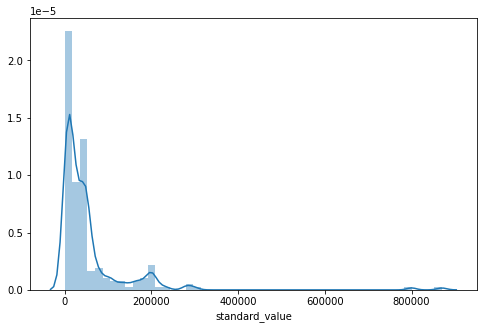

In [ ]:
import seaborn as sns

plt.figure(figsize=(8,5))
sns.distplot(df6.standard_value)

### Now need to convert IC50 to negative log scale (-log10(IC50)) which gives us a more uniform distribution for prediction.

In [ ]:
def pIC50(input):
    pIC50 = []

    for i in input['standard_value_norm']:
        molar = i*(10**-9) # Converts nanoMolar to Molar
        pIC50.append(-np.log10(molar))

    input['pIC50'] = pIC50
    x = input.drop('standard_value_norm', 1)
        
    return x

### We will max out values at 100000000 to make it easier for us.  This gets rid of negative values if negative log is calculated.

In [ ]:
df6.standard_value.dropna(inplace=True)

In [ ]:
df6.standard_value = pd.to_numeric(df6.standard_value).astype(float)

In [ ]:
def norm_value(input):
    norm = []

    for i in input['standard_value']:
        if i > 100000000:
          i = 100000000
        norm.append(i)

    input['standard_value_norm'] = norm
    x = input.drop('standard_value', 1)
        
    return x

In [ ]:
df_normalized = norm_value(df6)
df_normalized.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,MW,LogP,NumHDonors,NumHAcceptors,standard_value_norm
0,CHEMBL194398,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,inactive,580.682,2.68582,3.0,8.0,870000.0
1,CHEMBL393608,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,547.653,1.39862,4.0,8.0,200000.0
2,CHEMBL238216,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,581.670,1.59522,4.0,8.0,300000.0
3,CHEMBL235873,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,659.781,0.87060,6.0,9.0,15000.0
4,CHEMBL397154,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,625.764,0.67400,6.0,9.0,10000.0
5,CHEMBL238217,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,636.787,2.07480,5.0,9.0,80000.0
6,CHEMBL196635,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,558.676,2.79942,3.0,8.0,800000.0
7,CHEMBL492571,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccccc2)c1,intermediate,297.310,3.00790,3.0,4.0,5400.0
8,CHEMBL522710,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccc(Cl)cc2)c1,inactive,331.755,3.66130,3.0,4.0,11000.0
9,CHEMBL492771,O=C(O)/C(O)=C/C(=O)c1cccc(OCc2ccc(Cl)cc2)c1,inactive,332.739,3.62820,2.0,4.0,13600.0


In [ ]:
df7 = pIC50(df_normalized)
df7.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,MW,LogP,NumHDonors,NumHAcceptors,pIC50
0,CHEMBL194398,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H...,inactive,580.682,2.68582,3.0,8.0,3.060481
1,CHEMBL393608,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,547.653,1.39862,4.0,8.0,3.698970
2,CHEMBL238216,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,581.670,1.59522,4.0,8.0,3.522879
3,CHEMBL235873,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,659.781,0.87060,6.0,9.0,4.823909
4,CHEMBL397154,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,625.764,0.67400,6.0,9.0,5.000000
5,CHEMBL238217,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,636.787,2.07480,5.0,9.0,4.096910
6,CHEMBL196635,CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H]...,inactive,558.676,2.79942,3.0,8.0,3.096910
7,CHEMBL492571,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccccc2)c1,intermediate,297.310,3.00790,3.0,4.0,5.267606
8,CHEMBL522710,O=C(O)/C(O)=C/C(=O)c1cccc(NCc2ccc(Cl)cc2)c1,inactive,331.755,3.66130,3.0,4.0,4.958607
9,CHEMBL492771,O=C(O)/C(O)=C/C(=O)c1cccc(OCc2ccc(Cl)cc2)c1,inactive,332.739,3.62820,2.0,4.0,4.866461


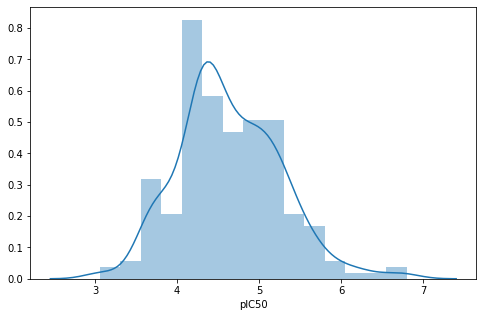

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(df7.pIC50)

In [ ]:
df7.pIC50.describe()

count    214.000000
mean       4.635885
std        0.619425
min        3.060481
25%        4.301030
50%        4.545166
75%        5.050691
max        6.795880
Name: pIC50, dtype: float64

### Removing intermediate class

In [ ]:
df_2class = df7[df7.bioactivity_class != 'intermediate']

Looking at Active vs Inactive molecules

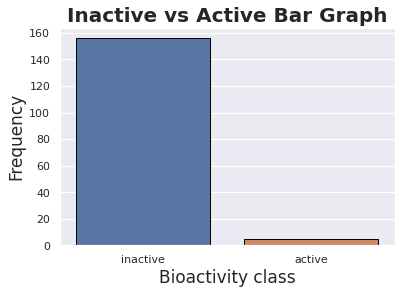

In [ ]:
sns.set(style='darkgrid')
sns.countplot(x='bioactivity_class', data = df_2class, edgecolor='black')

plt.xlabel('Bioactivity class', fontsize = 17)
plt.ylabel('Frequency', fontsize = 17)
plt.title('Inactive vs Active Bar Graph', size = 20, fontweight = 'bold')

plt.savefig('plot_bioactivity_class.png')

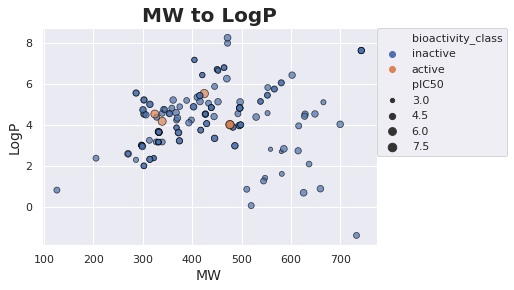

In [ ]:
sns.scatterplot(x='MW', y='LogP', data=df_2class, hue='bioactivity_class', size='pIC50', edgecolor='black', alpha=0.7)

plt.xlabel('MW', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('MW to LogP', size = 20, fontweight = 'bold')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0, fancybox = True)

plt.savefig('plot_MW_vs_LogP.png')

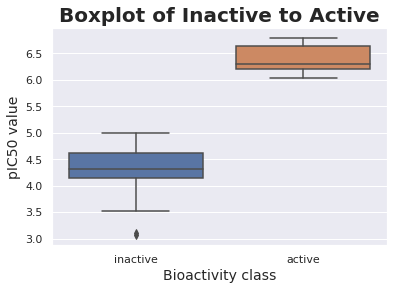

In [ ]:
sns.boxplot(x = 'bioactivity_class', y = 'pIC50', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('pIC50 value', fontsize=14)
plt.title('Boxplot of Inactive to Active', size = 20, fontweight = 'bold')

plt.savefig('plot_ic50.png')

### Now a Mann-Whitney U Test to make sure both groups are statistically different.  This MannWhitney test is for active vs inactive bioactivity.

In [ ]:
def mannwhitney(descriptor, verbose=True):
    from numpy.random import seed
    from numpy.random import randn
    from scipy.stats import mannwhitneyu


    seed(42)

### actives and inactives
    selection = [descriptor, 'bioactivity_class']
    df = df_2class[selection]
    active = df[df.bioactivity_class == 'active']
    active = active[descriptor]

    selection = [descriptor, 'bioactivity_class']
    df = df_2class[selection]
    inactive = df[df.bioactivity_class == 'inactive']
    inactive = inactive[descriptor]

### comparing samples
    stat, p = mannwhitneyu(active, inactive)
    print('Statistics=%.3f, p=%.3f' % (stat, p))

### interpret
    alpha = 0.05
    if p > alpha:
        interpretation = 'Same distribution (fail to reject H0)'
    else:
        interpretation = 'Different distribution (reject H0)'
  
    results = pd.DataFrame({'Descriptor':descriptor,
                          'Statistics':stat,
                          'p':p,
                          'alpha':alpha,
                          'Interpretation':interpretation}, index=[0])
    #filename = 'mannwhitneyu_' + descriptor + '.csv'
    #results.to_csv(filename)

    return results

In [ ]:
mannwhitney('pIC50')

Statistics=0.000, p=0.000


,Descriptor,Statistics,p,alpha,Interpretation
0,pIC50,0.0,0.00007,0.05,Different distribution (reject H0)


Molecular Weight

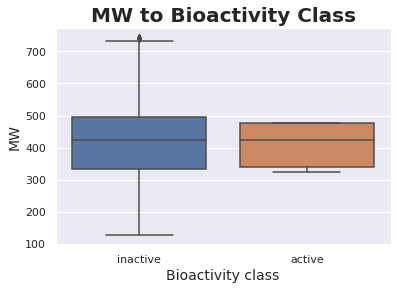

In [ ]:
sns.boxplot(x = 'bioactivity_class', y = 'MW', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('MW', fontsize=14)
plt.title('MW to Bioactivity Class', size = 20, fontweight = 'bold')

plt.savefig('plot_MW.png')

In [ ]:
mannwhitney('MW')

Statistics=364.500, p=0.404


,Descriptor,Statistics,p,alpha,Interpretation
0,MW,364.5,0.403749,0.05,Same distribution (fail to reject H0)


LogP

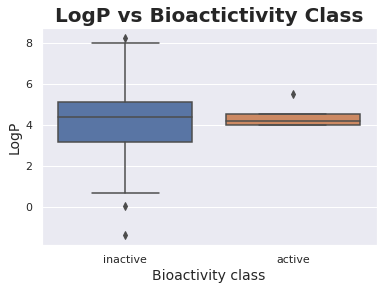

In [ ]:
sns.boxplot(x = 'bioactivity_class', y = 'LogP', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('LogP vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_LogP.png')

In [ ]:
mannwhitney('LogP')

Statistics=351.000, p=0.354


,Descriptor,Statistics,p,alpha,Interpretation
0,LogP,351.0,0.353743,0.05,Same distribution (fail to reject H0)


Number of Hydrogen Donors

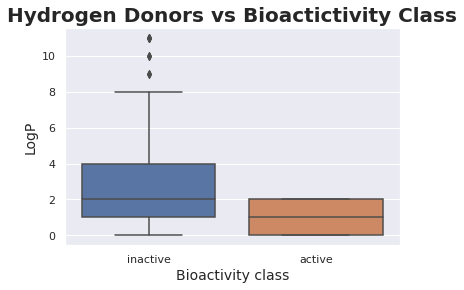

In [ ]:
sns.boxplot(x = 'bioactivity_class', y = 'NumHDonors', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('Hydrogen Donors vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_NumHDonors.png')

In [ ]:
mannwhitney('NumHDonors')

Statistics=198.000, p=0.029


,Descriptor,Statistics,p,alpha,Interpretation
0,NumHDonors,198.0,0.029272,0.05,Different distribution (reject H0)


Number of Hydrogen Acceptors

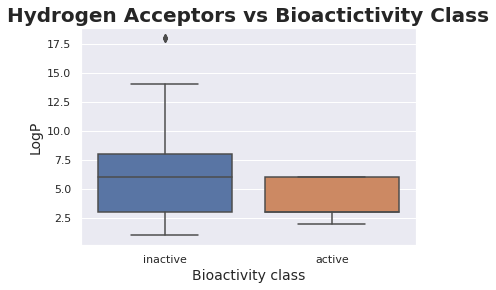

In [ ]:
sns.boxplot(x = 'bioactivity_class', y = 'NumHAcceptors', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('Hydrogen Acceptors vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_NumHacceptors.png')

In [ ]:
mannwhitney('NumHAcceptors')

Statistics=227.500, p=0.056


,Descriptor,Statistics,p,alpha,Interpretation
0,NumHAcceptors,227.5,0.055776,0.05,Same distribution (fail to reject H0)


### Interpretations

### pIC50 ------------ Statistically significant (This is expected as we pre-processed this data to split active and inactive)
### MW -------------- Not significant
### LogP ------------ Not significant
### H Donors ------ Statistically significant
### H Acceptors -- Not significant

In [ ]:
df_2class.to_csv('df_2class.csv', index=False)

We will now use PaDEL to calculate the molecular descriptors.

In [ ]:
! wget https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
! wget https://github.com/dataprofessor/bioinformatics/raw/master/padel.sh

--2020-09-06 00:33:05--  https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip [following]
--2020-09-06 00:33:06--  https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25768637 (25M) [application/zip]
Saving to: ‘padel.zip’

padel.zip           100%[===================>]  24.57M  43.1MB/s    in 0.6s    

2020-09-06 00:33:07 (43.1 MB/s) - ‘padel.zip’ saved [25768637/25768637]

--2020-09-06 00:33:07--  https://github.com

In [ ]:
! unzip padel.zip

Archive:  padel.zip
   creating: PaDEL-Descriptor/
  inflating: __MACOSX/._PaDEL-Descriptor  
  inflating: PaDEL-Descriptor/MACCSFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._MACCSFingerprinter.xml  
  inflating: PaDEL-Descriptor/AtomPairs2DFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._AtomPairs2DFingerprinter.xml  
  inflating: PaDEL-Descriptor/EStateFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._EStateFingerprinter.xml  
  inflating: PaDEL-Descriptor/Fingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._Fingerprinter.xml  
  inflating: PaDEL-Descriptor/.DS_Store  
  inflating: __MACOSX/PaDEL-Descriptor/._.DS_Store  
   creating: PaDEL-Descriptor/license/
  inflating: __MACOSX/PaDEL-Descriptor/._license  
  inflating: PaDEL-Descriptor/KlekotaRothFingerprintCount.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._KlekotaRothFingerprintCount.xml  
  inflating: PaDEL-Descriptor/config  
  inflating: __MACOSX/PaDEL-Descriptor/._config  
  inf

In [ ]:
df_2class.dropna(inplace=True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
selection = ['canonical_smiles','molecule_chembl_id']
df3_selection = df3[selection]
df3_selection.to_csv('molecule.smi', sep='\t', index=False, header=False)

In [ ]:
! cat molecule.smi | head -5

CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@@H](CC(=O)[C@@H](NC(=O)c1cc(C)on1)C(C)C)Cc1ccccc1	CHEMBL194398
CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@@H](NC(=O)c1cc(C)on1)C(C)C	CHEMBL393608
CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H](Cc1ccccc1)NC(=O)[C@@H](NC(=O)c1cc(C)on1)C(C)C	CHEMBL238216
CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H](Cc1ccccc1)NC(=O)[C@@H](NC(=O)[C@H](CO)NC(=O)OC(C)(C)C)C(C)C	CHEMBL235873
CCOC(=O)/C=C/[C@H](C[C@@H]1CCNC1=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@@H](NC(=O)[C@H](CO)NC(=O)OC(C)(C)C)C(C)C	CHEMBL397154


In [ ]:
 cat molecule.smi | wc -l   ### We have 215 molecules to look transcribe.

215


Calculating descriptors

In [ ]:
! cat padel.sh

java -Xms1G -Xmx1G -Djava.awt.headless=true -jar ./PaDEL-Descriptor/PaDEL-Descriptor.jar -removesalt -standardizenitro -fingerprints -descriptortypes ./PaDEL-Descriptor/PubchemFingerprinter.xml -dir ./ -file descriptors_output.csv


### Showing what is inside padel file in above line of code.  This uses Java with 1 gig of memory.  We removed the sodium and chloride (salts) which are in the chemical structure.

In [ ]:
! bash padel.sh

Processing CHEMBL194398 in molecule.smi (1/215). 
Processing CHEMBL393608 in molecule.smi (2/215). 
Processing CHEMBL238216 in molecule.smi (3/215). Average speed: 2.64 s/mol.
Processing CHEMBL235873 in molecule.smi (4/215). Average speed: 1.59 s/mol.
Processing CHEMBL397154 in molecule.smi (5/215). Average speed: 1.49 s/mol.
Processing CHEMBL238217 in molecule.smi (6/215). Average speed: 1.24 s/mol.
Processing CHEMBL492571 in molecule.smi (8/215). Average speed: 1.02 s/mol.
Processing CHEMBL196635 in molecule.smi (7/215). Average speed: 1.14 s/mol.
Processing CHEMBL492771 in molecule.smi (10/215). Average speed: 0.85 s/mol.
Processing CHEMBL522710 in molecule.smi (9/215). Average speed: 0.95 s/mol.
Processing CHEMBL492771 in molecule.smi (11/215). Average speed: 0.82 s/mol.
Processing CHEMBL492772 in molecule.smi (12/215). Average speed: 0.74 s/mol.
Processing CHEMBL492768 in molecule.smi (14/215). Average speed: 0.68 s/mol.
Processing CHEMBL492768 in molecule.smi (13/215). Average sp

Preparing the X and Y Data Matrices

X Matrix

In [ ]:
df_X_matrix = pd.read_csv('descriptors_output.csv')

In [ ]:
df_X_matrix

In [ ]:
df_X_matrix = df_X_matrix.drop(columns=['Name'])
df_X_matrix

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

### Y variable

COnverting IC50 to pIC50

In [ ]:
df_y = df7['pIC50']
df_y.dropna(inplace=True)

In [ ]:
df_y

0      3.060481
1      3.698970
2      3.522879
3      4.823909
4      5.000000
5      4.096910
6      3.096910
7      5.267606
8      4.958607
9      4.866461
10     4.612610
11     4.542118
12     4.399027
13     4.384050
14     4.301030
15     4.301030
16     4.301030
17     4.301030
18     4.301030
19     4.301030
20     4.301030
21     4.301030
22     4.301030
23     6.301030
24     5.602060
25     5.420216
26     4.978811
27     5.698970
28     5.180456
29     5.000000
30     5.267606
31     5.136677
32     4.301030
33     4.301030
34     4.301030
35     4.301030
36     4.301030
37     4.301030
38     4.301030
39     5.091515
40     4.301030
41     4.301030
42     4.679854
43     5.387216
44     4.301030
45     5.283997
46     4.595166
47     5.568636
48     4.301030
49     5.031517
50     4.301030
51     4.812479
52     4.367543
53     5.091515
54     4.397940
55     4.987163
56     5.259637
57     5.004365
58     5.585027
59     4.663540
60     4.628932
61     4.744727
62     4

Combining

In [ ]:
final_dataset = pd.concat([df_X_matrix,df_y], axis=1)

In [ ]:
missdata = df.isnull().values.any()
print(missdata)

True


In [ ]:
if missdata == True:
    print('# of missing values:', final_dataset.isnull().values.sum())
else:
    print('No missing data')

# of missing values: 1


In [ ]:
final_dataset.isnull().sum()

PubchemFP0      0
PubchemFP1      0
PubchemFP2      0
PubchemFP3      0
PubchemFP4      0
               ..
PubchemFP877    0
PubchemFP878    0
PubchemFP879    0
PubchemFP880    0
pIC50           1
Length: 882, dtype: int64

In [ ]:
final_dataset = final_dataset.dropna(axis=0)   ### Removing one final NaN value found in matrix.

In [ ]:
final_dataset

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

In [ ]:
final_dataset.to_csv('final_dataset,csv', index=False)

Modeling

In [ ]:
final_dataset = pd.read_csv('final_dataset,csv')

In [ ]:
final_dataset

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [ ]:
X = final_dataset.drop('pIC50', axis=1).copy()
y = final_dataset.pIC50.copy()

In [ ]:
X.shape

(214, 881)

In [ ]:
y.shape

(214,)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [ ]:
model = RandomForestRegressor(n_estimators=100)
model.fit(X_train, y_train)
R_square = model.score(X_test, y_test)
R_square

0.14957429318976445

In [ ]:
y_pred = model.predict(X_test)

Scatterplot of Predicted vs Experimental pIC50

<function matplotlib.pyplot.show>

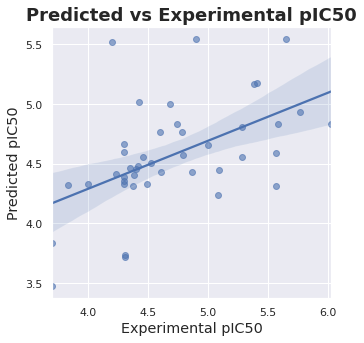

In [ ]:
ax = sns.regplot(y_test, y_pred, scatter_kws = {'alpha':0.6})
ax.set_xlabel('Experimental pIC50', fontsize = 'large')
ax.set_ylabel('Predicted pIC50', fontsize='large')
plt.title('Predicted vs Experimental pIC50', size = 18, fontweight = 'bold')
ax.figure.set_size_inches(5, 5)
plt.show

In [ ]:
import plotly.express as px

fig = px.scatter(y_test, y_pred, color = "pIC50")

fig.update_layout(
    height=600,
    width=1200,
    title_text='Predicted vs Experimental pIC50')

fig.show()

A good molecule to investigate would have a pIC50 of near 5.5 or greater.  This would give a stronger inhibition of the binded protein on SARs virus.